# Homework 6 - Generative Adversarial Network
This is the sample code for hw6 of 2022 Machine Learning course in National Taiwan University.

In this sample code, there are 5 sections:
1. Environment setting
2. Dataset preparation
3. Model setting
4. Train
5. Inference

Your goal is to do anime face generation, if you have any question, please discuss at NTU COOL

# Environment setting
In this section, we will prepare for the dataset and set some environment variable

## Download Dataset

In [1]:
data_path = '../faces'
# get dataset from huggingface hub
#!curl -s https://packagecloud.io/install/repositories/github/git-lfs/script.deb.sh | bash
#!apt-get install git-lfs
#!git lfs install
#!git clone https://huggingface.co/datasets/LeoFeng/MLHW_6
#!unzip ./MLHW_6/faces.zip -d .

## Other setting

In [2]:
# import module
import os
import glob
import random
from datetime import datetime

import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision
import torchvision.transforms as transforms
from torch import optim
from torch.autograd import Variable, grad # 这个grad函数是pytorch的自动求导函数，用于计算gradient penalty
from torch.utils.data import Dataset, DataLoader

import matplotlib.pyplot as plt
import numpy as np
import logging
from tqdm import tqdm


# seed setting
def same_seeds(seed):
    # Python built-in random module
    random.seed(seed)
    # Numpy
    np.random.seed(seed)
    # Torch
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed(seed)
        torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.benchmark = False
    torch.backends.cudnn.deterministic = True

same_seeds(4595)
workspace_dir = '.'

# Dataset preparation
In this section, we prepare for the dataset for Pytorch

## Create dataset for Pytorch

In order to unified image information, we use the transform function to:
1. Resize image to 64x64
2. Normalize the image

This CrypkoDataset class will be use in Section 4

In [3]:
# prepare for CrypkoDataset

class CrypkoDataset(Dataset):
    def __init__(self, fnames, transform):
        self.transform = transform
        self.fnames = fnames
        self.num_samples = len(self.fnames)

    def __getitem__(self,idx):
        fname = self.fnames[idx]
        img = torchvision.io.read_image(fname)
        img = self.transform(img)
        return img

    def __len__(self):
        return self.num_samples

def get_dataset(root):
    fnames = glob.glob(os.path.join(root, '*'))
    compose = [
        transforms.ToPILImage(),
        transforms.Resize((64, 64)),
        transforms.ToTensor(),
        transforms.Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5)),
    ]
    transform = transforms.Compose(compose)
    dataset = CrypkoDataset(fnames, transform)
    return dataset

## Show the image
Show some sample in the dataset

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


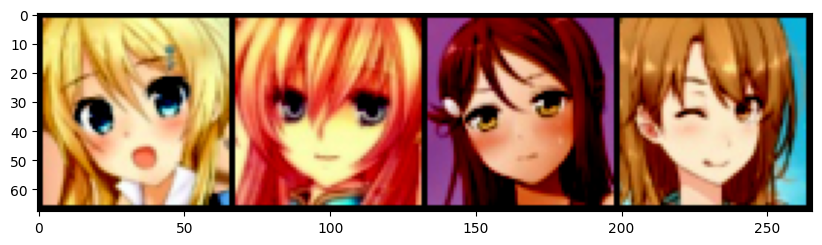

In [4]:
temp_dataset = get_dataset(os.path.join(workspace_dir, data_path))

images = [temp_dataset[i] for i in range(4)]
grid_img = torchvision.utils.make_grid(images, nrow=4)
plt.figure(figsize=(10,10))
plt.imshow(grid_img.permute(1, 2, 0))
plt.show()

# Model setting
In this section, we will create models and trainer.

## Create model
In this section, we will create models for Generator and Discriminator

In [5]:
# Generator

class Generator(nn.Module):
    """
    Input shape: (batch, in_dim)
    Output shape: (batch, 3, 64, 64)
    """
    def __init__(self, in_dim, feature_dim=64):
        super().__init__()

        #input: (batch, 100)
        self.l1 = nn.Sequential(
            nn.Linear(in_dim, feature_dim * 8 * 4 * 4, bias=False),
            nn.BatchNorm1d(feature_dim * 8 * 4 * 4),
            nn.ReLU()
        )
        self.l2 = nn.Sequential(
            self.dconv_bn_relu(feature_dim * 8, feature_dim * 4),               #(batch, feature_dim * 16, 8, 8)
            self.dconv_bn_relu(feature_dim * 4, feature_dim * 2),               #(batch, feature_dim * 16, 16, 16)
            self.dconv_bn_relu(feature_dim * 2, feature_dim),                   #(batch, feature_dim * 16, 32, 32)
        )
        self.l3 = nn.Sequential(
            nn.ConvTranspose2d(feature_dim, 3, kernel_size=5, stride=2,
                               padding=2, output_padding=1, bias=False),
            nn.Tanh()
        )
        self.apply(weights_init)
    def dconv_bn_relu(self, in_dim, out_dim):
        return nn.Sequential(
            nn.ConvTranspose2d(in_dim, out_dim, kernel_size=5, stride=2,
                               padding=2, output_padding=1, bias=False),        #double height and width
            nn.BatchNorm2d(out_dim),
            nn.ReLU(True) # inplace = true
        )
    def forward(self, x):
        y = self.l1(x)
        y = y.view(y.size(0), -1, 4, 4)
        y = self.l2(y)
        y = self.l3(y)
        return y

In [6]:
# Discriminator
class Discriminator(nn.Module):
    """
    Input shape: (batch, 3, 64, 64)
    Output shape: (batch)
    """
    def __init__(self, config, in_dim, feature_dim=64):
        super(Discriminator, self).__init__()

        #input: (batch, 3, 64, 64)
        """
        NOTE FOR SETTING DISCRIMINATOR:

        Remove last sigmoid layer for WGAN
        """
        self.config = config # 记录具体是什么GAN
        if (self.config["model_type"] == 'GAN'):
            self.l1 = nn.Sequential(
                nn.Conv2d(in_dim, feature_dim, kernel_size=4, stride=2, padding=1), #(batch, 3, 32, 32)
                nn.LeakyReLU(0.2),
                self.conv_bn_lrelu(feature_dim, feature_dim * 2),                   #(batch, 3, 16, 16)
                self.conv_bn_lrelu(feature_dim * 2, feature_dim * 4),               #(batch, 3, 8, 8)
                self.conv_bn_lrelu(feature_dim * 4, feature_dim * 8),               #(batch, 3, 4, 4)
                nn.Conv2d(feature_dim * 8, 1, kernel_size=4, stride=1, padding=0),
                nn.Sigmoid()
            )
        else: # 所有WGAN都不能有Sigmoid
            self.l1 = nn.Sequential(
                nn.Conv2d(in_dim, feature_dim, kernel_size=4, stride=2, padding=1), #(batch, 3, 32, 32)
                nn.LeakyReLU(0.2),
                self.conv_bn_lrelu(feature_dim, feature_dim * 2),                   #(batch, 3, 16, 16)
                self.conv_bn_lrelu(feature_dim * 2, feature_dim * 4),               #(batch, 3, 8, 8)
                self.conv_bn_lrelu(feature_dim * 4, feature_dim * 8),               #(batch, 3, 4, 4)
                nn.Conv2d(feature_dim * 8, 1, kernel_size=4, stride=1, padding=0),
            )
        self.apply(weights_init)
    def conv_bn_lrelu(self, in_dim, out_dim):
        
        '''
        对于WGAN-gp的判别器，是不能加 batchNorm 的，
        原因很简单， 是因为WGAN-gp的惩罚项计算中，惩罚的是单个数据的gradient norm，如果使用 batchNorm，就会扰乱这种惩罚，让这种特别的惩罚失效。 
        当然你可以绕过 batchNorm, 使用 layerNorm 或者 InstanceNorm
        '''
        """
        NOTE FOR SETTING DISCRIMINATOR:

        You can't use nn.Batchnorm for WGAN-GP
        Use nn.InstanceNorm2d instead
        """
        if (self.config["model_type"] == 'WGAN-GP'):
            return nn.Sequential(
                nn.Conv2d(in_dim, out_dim, 4, 2, 1),
                nn.InstanceNorm2d(out_dim), # 最后一个注意点就是WGAN-GP不能用Batch Normalization，因为我们是对每个样本单独施加Gradient Penalty，用了Batch Normalization会引入样本间的相互依赖关系。但是可以用其他Normalization。
                nn.LeakyReLU(0.2),
            )
        
        return nn.Sequential( # 如果不是
            nn.Conv2d(in_dim, out_dim, 4, 2, 1),
            nn.BatchNorm2d(out_dim),
            nn.LeakyReLU(0.2),
        )
    
    def forward(self, x):
        y = self.l1(x)
        y = y.view(-1)
        return y

In [7]:
# setting for weight init function
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)

## Create trainer
In this section, we will create a trainer which contains following functions:
1. prepare_environment: prepare the overall environment, construct the models, create directory for the log and ckpt
2. train: train for generator and discriminator, you can try to modify the code here to construct WGAN or WGAN-GP
3. inference: after training, you can pass the generator ckpt path into it and the function will save the result for you

In [8]:
global_time = '' # 记录登记时间以在最后加载check point
class TrainerGAN():
    def __init__(self, config):
        self.config = config

        self.G = Generator(100)
        self.D = Discriminator(config = self.config, in_dim = 3)

        self.loss = nn.BCELoss()

        """
        NOTE FOR SETTING OPTIMIZER:

        GAN: use Adam optimizer
        WGAN: use RMSprop optimizer
        WGAN-GP: use Adam optimizer
        """
        if(config["model_type"] == 'GAN'):
            self.opt_D = torch.optim.Adam(self.D.parameters(), lr=self.config["lr"], weight_decay = self.config["weight_decay"], betas=(0.5, 0.999))
            self.opt_G = torch.optim.Adam(self.G.parameters(), lr=self.config["lr"], weight_decay = self.config["weight_decay"], betas=(0.5, 0.999))
        if(config["model_type"] == 'WGAN'):
            self.opt_D = torch.optim.RMSprop(self.D.parameters(), lr=self.config["lr"], weight_decay = self.config["weight_decay"])
            self.opt_G = torch.optim.RMSprop(self.G.parameters(), lr=self.config["lr"], weight_decay = self.config["weight_decay"])
        if(config["model_type"] == 'WGAN-GP'):
            self.opt_D = torch.optim.Adam(self.D.parameters(), lr=self.config["lr"], weight_decay = self.config["weight_decay"], betas=(0.5, 0.999))
            self.opt_G = torch.optim.Adam(self.G.parameters(), lr=self.config["lr"], weight_decay = self.config["weight_decay"], betas=(0.5, 0.999))

        self.dataloader = None
        self.log_dir = os.path.join(self.config["workspace_dir"], 'logs')
        self.ckpt_dir = os.path.join(self.config["workspace_dir"], 'checkpoints')

        FORMAT = '%(asctime)s - %(levelname)s: %(message)s'
        logging.basicConfig(level=logging.INFO,
                            format=FORMAT,
                            datefmt='%Y-%m-%d %H:%M')

        self.steps = 0
        self.z_samples = Variable(torch.randn(100, self.config["z_dim"])).cuda()

    def prepare_environment(self):
        """
        Use this funciton to prepare function
        """
        global global_time
        os.makedirs(self.log_dir, exist_ok=True)
        os.makedirs(self.ckpt_dir, exist_ok=True)

        # update dir by time
        time = datetime.now().strftime('%Y-%m-%d_%H-%M-%S')
        global_time = time
        self.log_dir = os.path.join(self.log_dir, time+f'_{self.config["model_type"]}')
        self.ckpt_dir = os.path.join(self.ckpt_dir, time+f'_{self.config["model_type"]}')
        os.makedirs(self.log_dir)
        os.makedirs(self.ckpt_dir)

        # create dataset by the above function
        dataset = get_dataset(os.path.join(self.config["workspace_dir"], data_path))
        self.dataloader = DataLoader(dataset, batch_size=self.config["batch_size"], shuffle=True, num_workers=2)

        # model preparation
        self.G = self.G.cuda()
        self.D = self.D.cuda()
        self.G.train()
        self.D.train()
    def gp(self, r_imgs : Variable, f_imgs : Variable): # 注意，这个Variable封装是老旧的实现，可以不用了现在
        """
        Implement gradient penalty function
        r_img : [batch, 3, 64, 64]
        """
        lamb = self.config["gp_config"]["lambda"]
        eps = random.random() # 从 0 ～ 1 中随机取eps噪声

        '''
        为了gradient penalty 我们甚至还需要再前向传播一次判别器
        '''

        x_sharp : torch.Tensor = eps * r_imgs + (1 - eps) * f_imgs # 随机权重加权得出x
        x_sharp.requires_grad_() # 需要求导
        x_sharp.cuda()
        D_x_sharp = self.D.forward(x_sharp) # 前向传播
        grad_D_x_sharp = grad( # autograd.grad, 输出的是输出对于输入的tensor梯度
            outputs = D_x_sharp, # outputs：这是你想要计算梯度的输出变量。在WGAN-GP的上下文中，outputs将是判别器对插值样本的输出。这个输出是需要对其进行微分的函数。
            inputs = x_sharp, # inputs：这些是你需要计算其相对于outputs的梯度的输入变量。在WGAN-GP中，inputs将是插值样本本身。你感兴趣的是如何根据这些插值样本调整判别器的输出。
            grad_outputs=torch.ones_like(D_x_sharp).cuda(), # 这是对outputs梯度的权重。
                                                              # 在大多数情况下，如果outputs是标量（即单个数值），你可以简单地将其设置为torch.ones_like(outputs)，
                                                              # 这意味着梯度不会被加权。在WGAN-GP的应用中，这通常是你所需要的，因为我们对计算梯度的绝对值感兴趣。
            create_graph=True, # 当这个参数设置为True时，会构建用于计算梯度的计算图，这允许你随后对这些梯度再次进行微分（即进行二次微分）。在WGAN-GP中，这是必要的，因为梯度惩罚涉及到梯度的梯度（即梯度的范数的梯度）
            retain_graph=True, # 如果设置为True，这个参数允许你多次使用grad函数，而不销毁中间计算图。在某些情况下，比如在计算梯度惩罚时，你可能需要保留计算图，以便进行额外的操作。
            only_inputs=True # 当设置为True时，grad函数只会返回指定inputs的梯度，而不是所有可能的自动微分变量的梯度。在大多数情况下，这正是你所需要的，因为你通常只对特定输入的梯度感兴趣。
        )[0] #取第一个就行了
        gp = ((grad_D_x_sharp.norm(p=2, dim=(1, 2)) - 1)**2).mean().cuda() # 计算每梯度的L2范数, 求平均
        return lamb * gp #正则化值


    def train(self):
        """
        Use this function to train generator and discriminator
        """
        self.prepare_environment()

        for e, epoch in enumerate(range(self.config["n_epoch"])):
            progress_bar = tqdm(self.dataloader)
            progress_bar.set_description(f"Epoch {e+1}")
            for i, data in enumerate(progress_bar):
                imgs = data.cuda()
                bs = imgs.size(0)

                # *********************
                # *    Train D        *
                # *********************
                z = Variable(torch.randn(bs, self.config["z_dim"])).cuda() # 这里用 variable 是为了兼容旧版pytroch，以前pytorch的tensor不带自动求导功能的，要封装成一个variable才行！
                r_imgs = Variable(imgs).cuda() # r_imgs: 真实的img
                f_imgs = self.G(z) # f_imgs: 生成的假img
                r_label = torch.ones((bs)).cuda()
                f_label = torch.zeros((bs)).cuda()


                # Discriminator forwarding
                r_logit = self.D(r_imgs)
                f_logit = self.D(f_imgs)

                """
                NOTE FOR SETTING DISCRIMINATOR LOSS:

                GAN:
                    loss_D = (r_loss + f_loss)/2
                WGAN:
                    loss_D = -torch.mean(r_logit) + torch.mean(f_logit)
                WGAN-GP:
                    gradient_penalty = self.gp(r_imgs, f_imgs)
                    loss_D = -torch.mean(r_logit) + torch.mean(f_logit) + gradient_penalty
                """
                # Loss for discriminator
                if(self.config["model_type"] == 'GAN'):
                    r_loss = self.loss(r_logit, r_label)
                    f_loss = self.loss(f_logit, f_label)
                    loss_D = (r_loss + f_loss) / 2
                elif(self.config["model_type"] == 'WGAN'):
                    loss_D = -torch.mean(r_logit) + torch.mean(f_logit)
                elif(self.config["model_type"] == 'WGAN-GP'):
                    gradient_penalty = self.gp(r_imgs, f_imgs)
                    loss_D =  -torch.mean(r_logit) + torch.mean(f_logit) + gradient_penalty
                else:
                    raise NameError("please cheke the config of 'model_type' ")

                # Discriminator backwarding
                self.D.zero_grad()
                loss_D.backward()
                self.opt_D.step()

                """
                NOTE FOR SETTING WEIGHT CLIP:

                WGAN: below code
                """
                if (self.config["model_type"] == 'WGAN'):
                    for p in self.D.parameters():
                        p.data.clamp_(-self.config["clip_value"], self.config["clip_value"])



                # *********************
                # *    Train G        *
                # *********************
                if self.steps % self.config["n_critic"] == 0:
                    # Generate some fake images.
                    z = Variable(torch.randn(bs, self.config["z_dim"])).cuda()
                    f_imgs = self.G(z)

                    # Generator forwarding
                    f_logit = self.D(f_imgs)


                    """
                    NOTE FOR SETTING LOSS FOR GENERATOR:

                    GAN: loss_G = self.loss(f_logit, r_label)
                    WGAN: loss_G = -torch.mean(self.D(f_imgs))
                    WGAN-GP: loss_G = -torch.mean(self.D(f_imgs))
                    """
                    # Loss for the generator.
                    if (self.config["model_type"] == 'GAN'):
                        loss_G = self.loss(f_logit, r_label)
                    elif(self.config["model_type"] == 'WGAN'):
                        loss_G = -torch.mean(self.D(f_imgs))
                    elif(self.config["model_type"] == 'WGAN-GP'):
                        loss_G = -torch.mean(self.D(f_imgs))
                    else:
                        raise NameError("please cheke the config of 'model_type' ")

                    # Generator backwarding
                    self.G.zero_grad()
                    loss_G.backward()
                    self.opt_G.step()

                if self.steps % 10 == 0:
                    progress_bar.set_postfix(loss_G=loss_G.item(), loss_D=loss_D.item())
                self.steps += 1

            self.G.eval()
            f_imgs_sample = (self.G(self.z_samples).data + 1) / 2.0
            filename = os.path.join(self.log_dir, f'Epoch_{epoch+1:03d}.jpg')
            torchvision.utils.save_image(f_imgs_sample, filename, nrow=10)
            logging.info(f'Save some samples to {filename}.')

            # Show some images during training.
            if ((e + 1) % 5 == 0 or e == 0 ): # 每隔上5次打印一次
                grid_img = torchvision.utils.make_grid(f_imgs_sample.cpu(), nrow=10)
                plt.figure(figsize=(10,10))
                plt.imshow(grid_img.permute(1, 2, 0))
                plt.show()

            self.G.train()

            if (e+1) % 5 == 0 or e == 0:
                # Save the checkpoints.
                torch.save(self.G.state_dict(), os.path.join(self.ckpt_dir, f'G_{e}.pth'))
                torch.save(self.D.state_dict(), os.path.join(self.ckpt_dir, f'D_{e}.pth'))

        logging.info('Finish training')

    def inference(self, G_path, n_generate=1000, n_output=30, show=False):
        """
        1. G_path is the path for Generator ckpt
        2. You can use this function to generate final answer
        """

        self.G.load_state_dict(torch.load(G_path))
        self.G.cuda()
        self.G.eval()
        z = Variable(torch.randn(n_generate, self.config["z_dim"])).cuda()
        imgs = (self.G(z).data + 1) / 2.0

        os.makedirs('output', exist_ok=True)
        for i in range(n_generate):
            torchvision.utils.save_image(imgs[i], f'output/{i+1}.jpg')

        if show:
            row, col = n_output//10 + 1, 10
            grid_img = torchvision.utils.make_grid(imgs[:n_output].cpu(), nrow=row)
            plt.figure(figsize=(row, col))
            plt.imshow(grid_img.permute(1, 2, 0))
            plt.show()

# Train
In this section, we will first set the config for trainer, then use it to train generator and discriminator

## Set config

In [9]:
gp_config = {
    "lambda" : 10,
}

config = {
    "model_type": "WGAN-GP",
    "clip_value": 1, # only for WGAN, 设定clip值
    "batch_size": 128,
    "lr": 0.0001,
    "weight_decay" : 1e-5,
    "n_epoch": 100,
    "n_critic": 1,
    "z_dim": 100,
    "gp_config" : gp_config, # 用于gradient_pernalty的config
    "workspace_dir": workspace_dir, # define in the environment setting
}


## Start to train

Epoch 1: 100%|██████████| 558/558 [00:43<00:00, 12.86it/s, loss_D=-90.8, loss_G=99.4] 
2024-02-26 22:36 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_001.jpg.


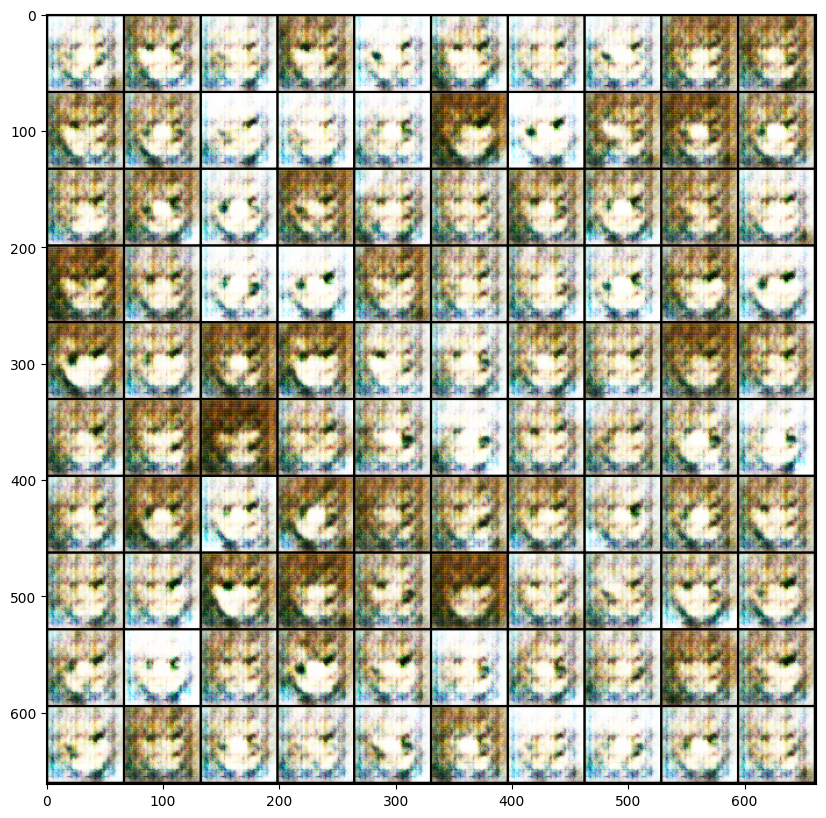

Epoch 2: 100%|██████████| 558/558 [00:41<00:00, 13.54it/s, loss_D=-50.6, loss_G=66.1]
2024-02-26 22:37 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_002.jpg.
Epoch 3: 100%|██████████| 558/558 [00:41<00:00, 13.57it/s, loss_D=-24.7, loss_G=71.7]
2024-02-26 22:38 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_003.jpg.
Epoch 4: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=-60.8, loss_G=93]  
2024-02-26 22:38 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_004.jpg.
Epoch 5: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=-58.9, loss_G=59.8]
2024-02-26 22:39 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_005.jpg.


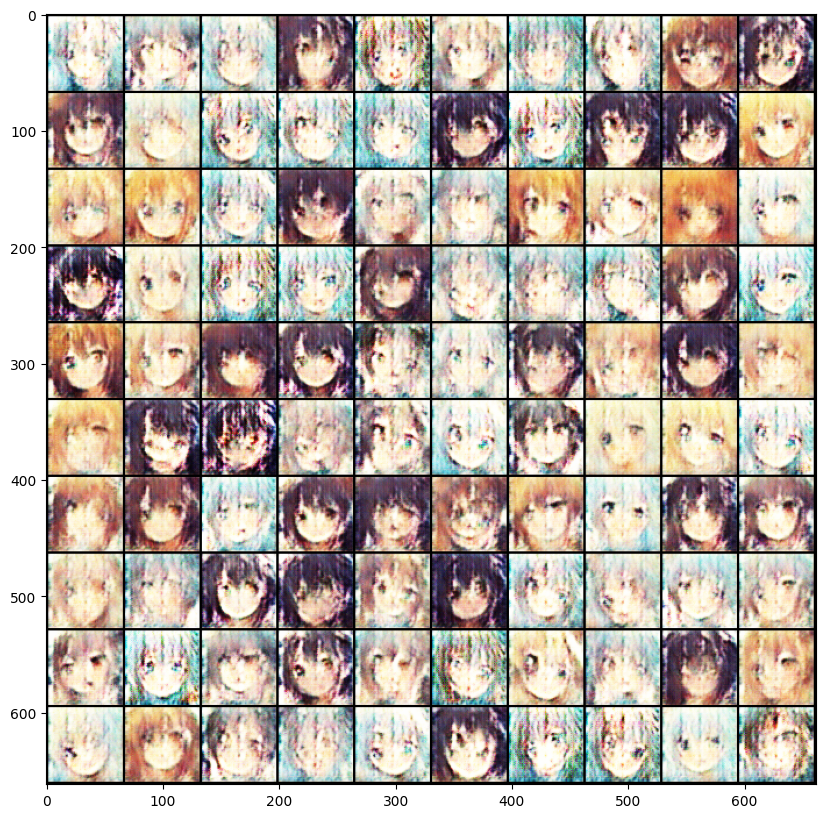

Epoch 6: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=-20.7, loss_G=143] 
2024-02-26 22:40 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_006.jpg.
Epoch 7: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=-38.9, loss_G=103] 
2024-02-26 22:40 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_007.jpg.
Epoch 8: 100%|██████████| 558/558 [00:41<00:00, 13.58it/s, loss_D=-41.8, loss_G=142] 
2024-02-26 22:41 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_008.jpg.
Epoch 9: 100%|██████████| 558/558 [00:41<00:00, 13.55it/s, loss_D=-31.2, loss_G=158] 
2024-02-26 22:42 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_009.jpg.
Epoch 10: 100%|██████████| 558/558 [00:41<00:00, 13.59it/s, loss_D=-36.5, loss_G=113] 
2024-02-26 22:42 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_010.jpg.


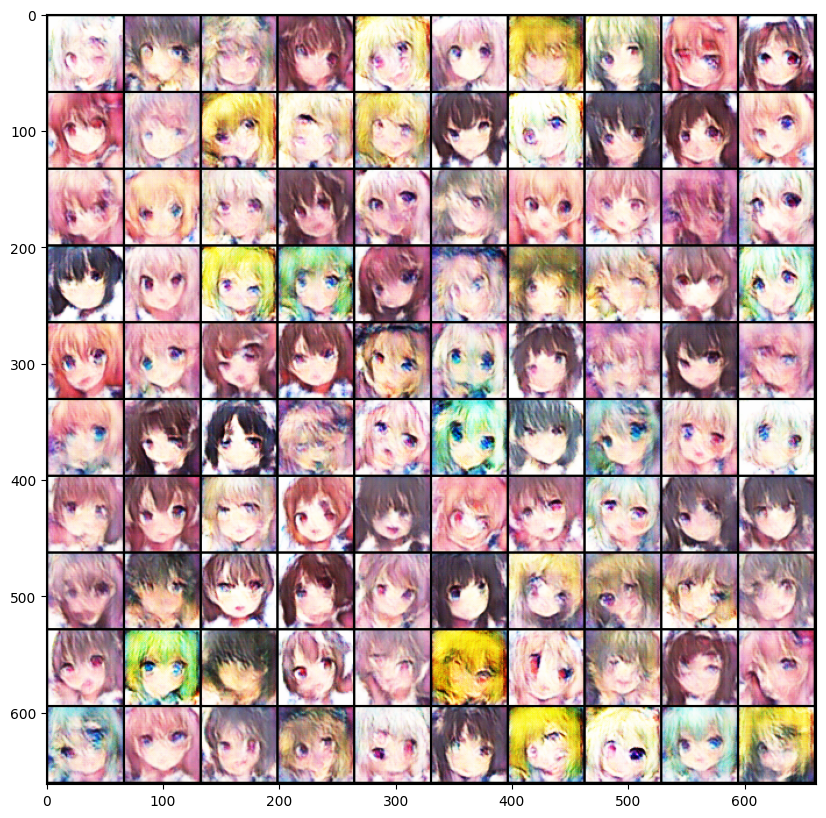

Epoch 11: 100%|██████████| 558/558 [00:41<00:00, 13.58it/s, loss_D=-59.5, loss_G=97.7]
2024-02-26 22:43 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_011.jpg.
Epoch 12: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=-7.15, loss_G=88]   
2024-02-26 22:44 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_012.jpg.
Epoch 13: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=-57.2, loss_G=84.1]
2024-02-26 22:44 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_013.jpg.
Epoch 14: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=-18.8, loss_G=94.9]
2024-02-26 22:45 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_014.jpg.
Epoch 15: 100%|██████████| 558/558 [00:41<00:00, 13.58it/s, loss_D=-55.5, loss_G=96.8]
2024-02-26 22:46 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_015.jpg.


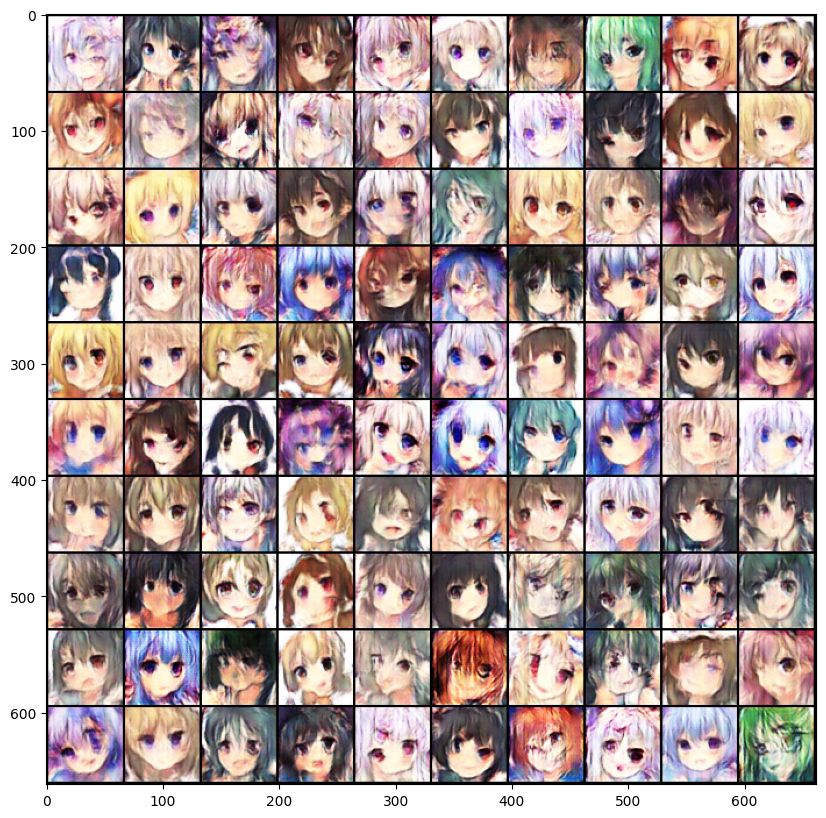

Epoch 16: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=15.9, loss_G=50.7] 
2024-02-26 22:47 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_016.jpg.
Epoch 17: 100%|██████████| 558/558 [00:41<00:00, 13.61it/s, loss_D=18.2, loss_G=99.6] 
2024-02-26 22:47 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_017.jpg.
Epoch 18: 100%|██████████| 558/558 [00:41<00:00, 13.58it/s, loss_D=-47, loss_G=51.9]  
2024-02-26 22:48 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_018.jpg.
Epoch 19: 100%|██████████| 558/558 [00:41<00:00, 13.58it/s, loss_D=-55.7, loss_G=60.4]  
2024-02-26 22:49 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_019.jpg.
Epoch 20: 100%|██████████| 558/558 [00:41<00:00, 13.57it/s, loss_D=-41.9, loss_G=61.9] 
2024-02-26 22:49 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_020.jpg.


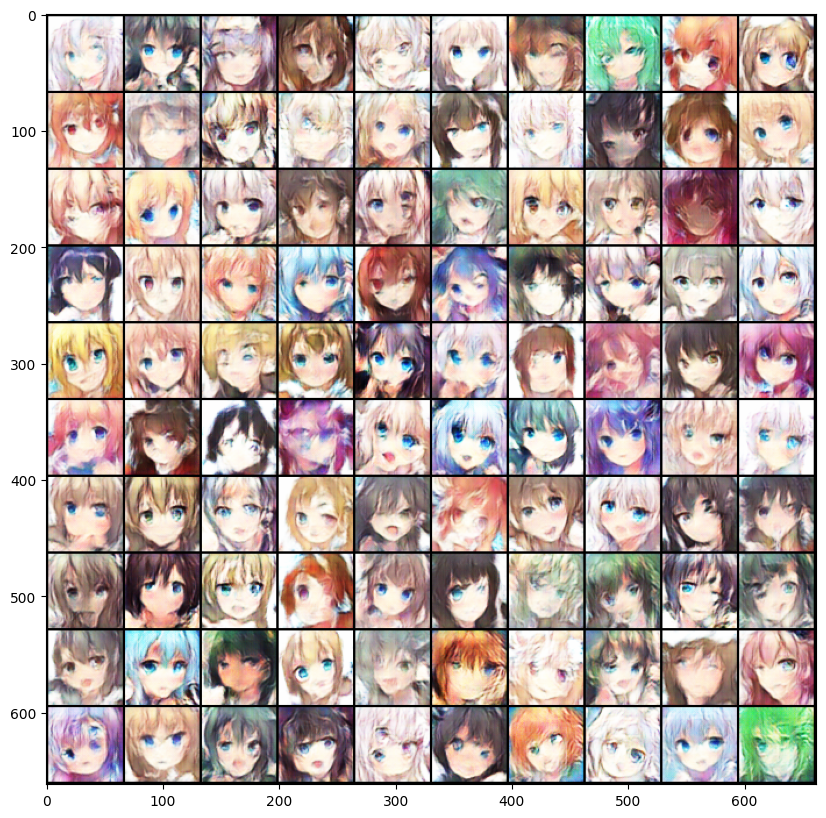

Epoch 21: 100%|██████████| 558/558 [00:41<00:00, 13.57it/s, loss_D=-34.1, loss_G=56.3] 
2024-02-26 22:50 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_021.jpg.
Epoch 22: 100%|██████████| 558/558 [00:41<00:00, 13.60it/s, loss_D=-26, loss_G=43.7]  
2024-02-26 22:51 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_022.jpg.
Epoch 23: 100%|██████████| 558/558 [00:41<00:00, 13.57it/s, loss_D=-33.6, loss_G=53]  
2024-02-26 22:51 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_023.jpg.
Epoch 24: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=-45.9, loss_G=72.9]
2024-02-26 22:52 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_024.jpg.
Epoch 25: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=-29.3, loss_G=60.1]
2024-02-26 22:53 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_025.jpg.


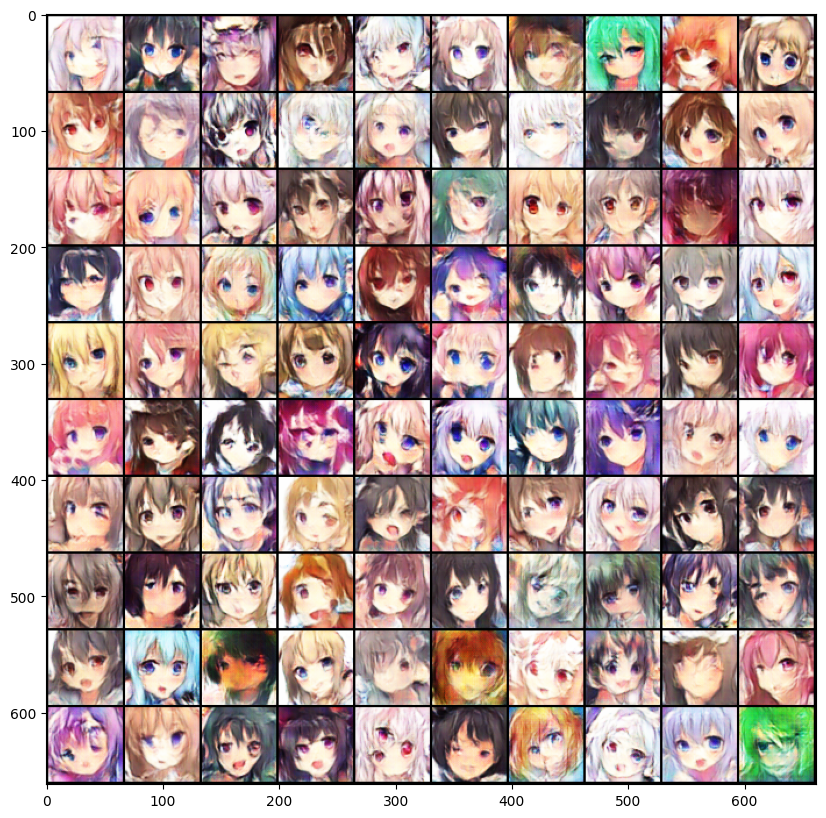

Epoch 26: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=-36.1, loss_G=50.2]
2024-02-26 22:53 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_026.jpg.
Epoch 27: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=-46.1, loss_G=83.5]
2024-02-26 22:54 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_027.jpg.
Epoch 28: 100%|██████████| 558/558 [00:41<00:00, 13.58it/s, loss_D=-48.7, loss_G=55.3] 
2024-02-26 22:55 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_028.jpg.
Epoch 29: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=-38.4, loss_G=45.3]
2024-02-26 22:55 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_029.jpg.
Epoch 30: 100%|██████████| 558/558 [00:41<00:00, 13.57it/s, loss_D=-37.3, loss_G=13.6]
2024-02-26 22:56 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_030.jpg.


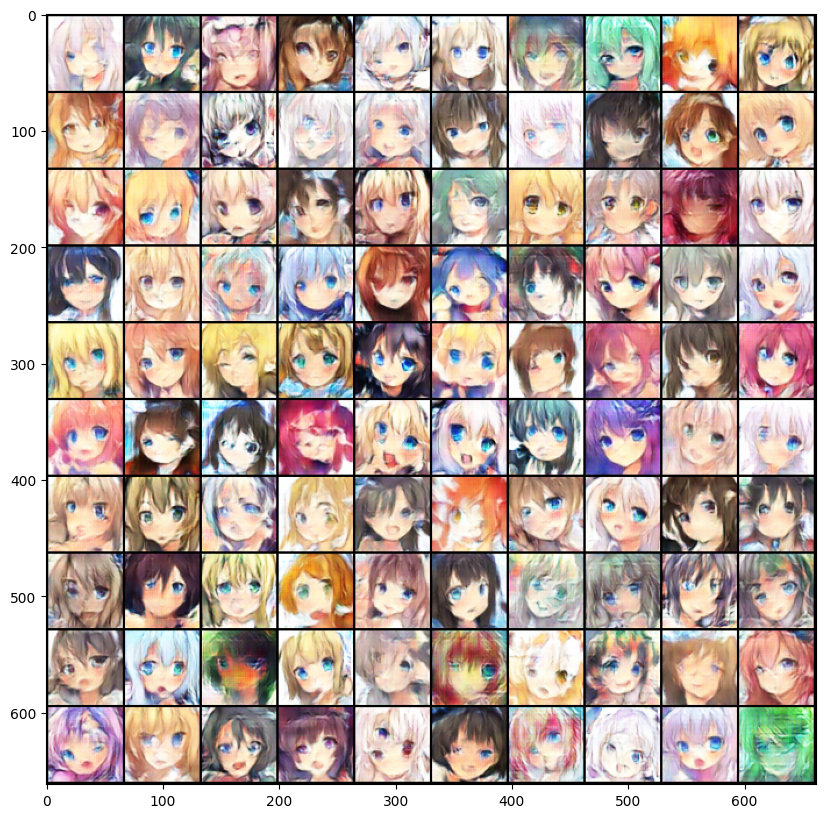

Epoch 31: 100%|██████████| 558/558 [00:41<00:00, 13.55it/s, loss_D=-37.8, loss_G=50.1] 
2024-02-26 22:57 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_031.jpg.
Epoch 32: 100%|██████████| 558/558 [00:41<00:00, 13.57it/s, loss_D=-21.9, loss_G=47]   
2024-02-26 22:58 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_032.jpg.
Epoch 33: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=-8, loss_G=81.9]     
2024-02-26 22:58 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_033.jpg.
Epoch 34: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=-44, loss_G=156]    
2024-02-26 22:59 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_034.jpg.
Epoch 35: 100%|██████████| 558/558 [00:41<00:00, 13.59it/s, loss_D=-38.2, loss_G=81.8] 
2024-02-26 23:00 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_035.jpg.


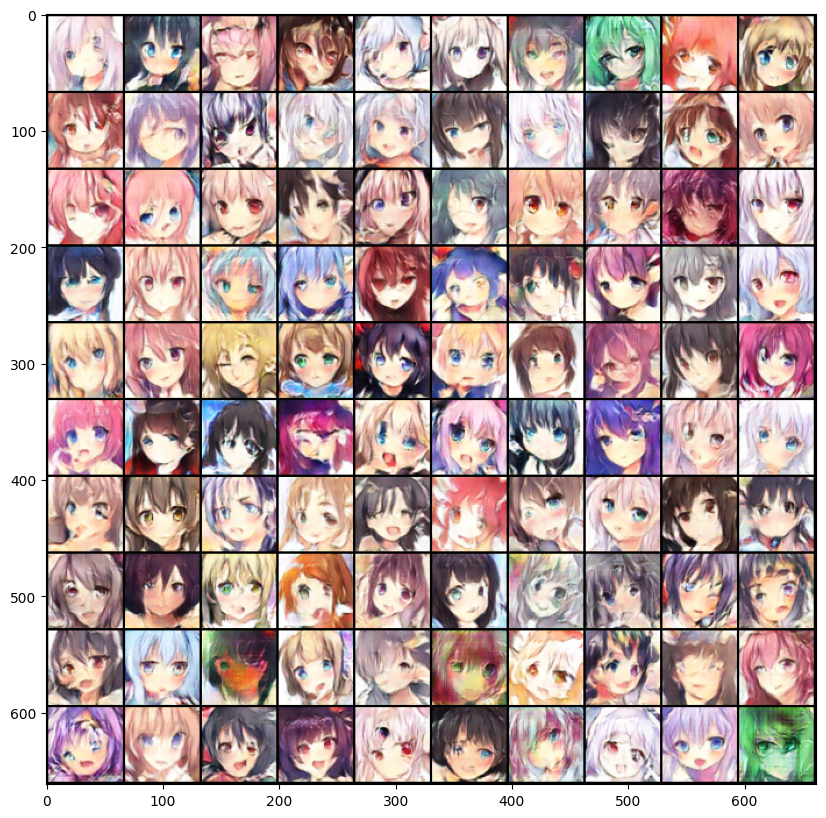

Epoch 36: 100%|██████████| 558/558 [00:41<00:00, 13.57it/s, loss_D=-40.2, loss_G=14.9] 
2024-02-26 23:00 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_036.jpg.
Epoch 37: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=-27.5, loss_G=56.4] 
2024-02-26 23:01 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_037.jpg.
Epoch 38: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=-34.9, loss_G=75.5] 
2024-02-26 23:02 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_038.jpg.
Epoch 39: 100%|██████████| 558/558 [00:41<00:00, 13.57it/s, loss_D=-6.75, loss_G=53.6]
2024-02-26 23:02 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_039.jpg.
Epoch 40: 100%|██████████| 558/558 [00:41<00:00, 13.58it/s, loss_D=-27.6, loss_G=86.4]
2024-02-26 23:03 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_040.jpg.


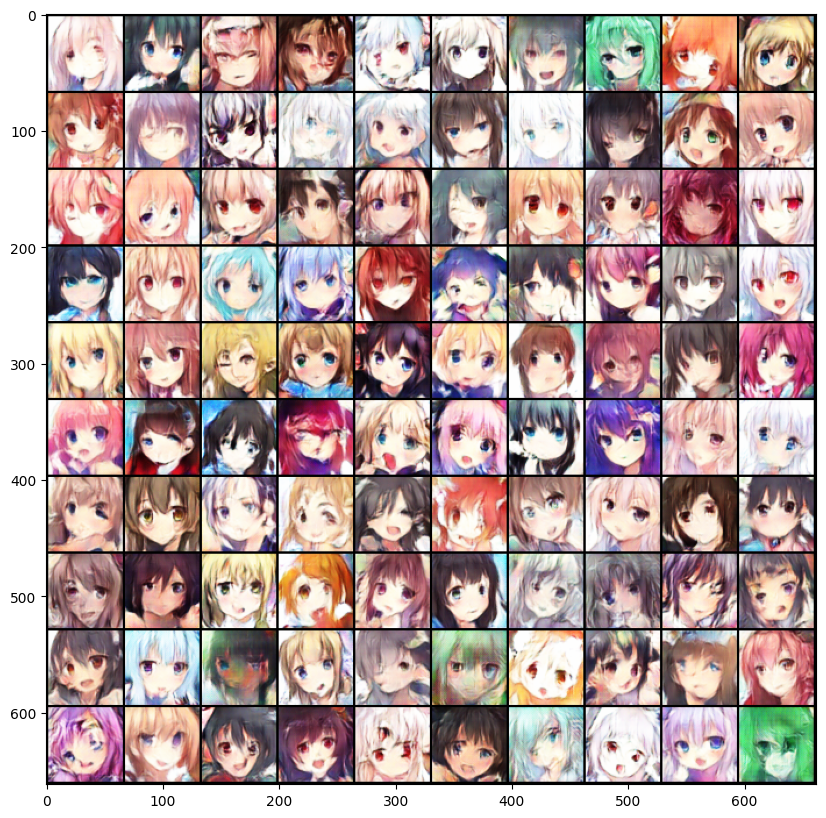

Epoch 41: 100%|██████████| 558/558 [00:41<00:00, 13.57it/s, loss_D=-35.6, loss_G=60.8] 
2024-02-26 23:04 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_041.jpg.
Epoch 42: 100%|██████████| 558/558 [00:41<00:00, 13.58it/s, loss_D=-27.2, loss_G=121]  
2024-02-26 23:04 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_042.jpg.
Epoch 43: 100%|██████████| 558/558 [00:41<00:00, 13.57it/s, loss_D=-31.7, loss_G=26.2] 
2024-02-26 23:05 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_043.jpg.
Epoch 44: 100%|██████████| 558/558 [00:41<00:00, 13.57it/s, loss_D=-35.1, loss_G=26.8]
2024-02-26 23:06 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_044.jpg.
Epoch 45: 100%|██████████| 558/558 [00:41<00:00, 13.57it/s, loss_D=-29.2, loss_G=95.3] 
2024-02-26 23:06 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_045.jpg.


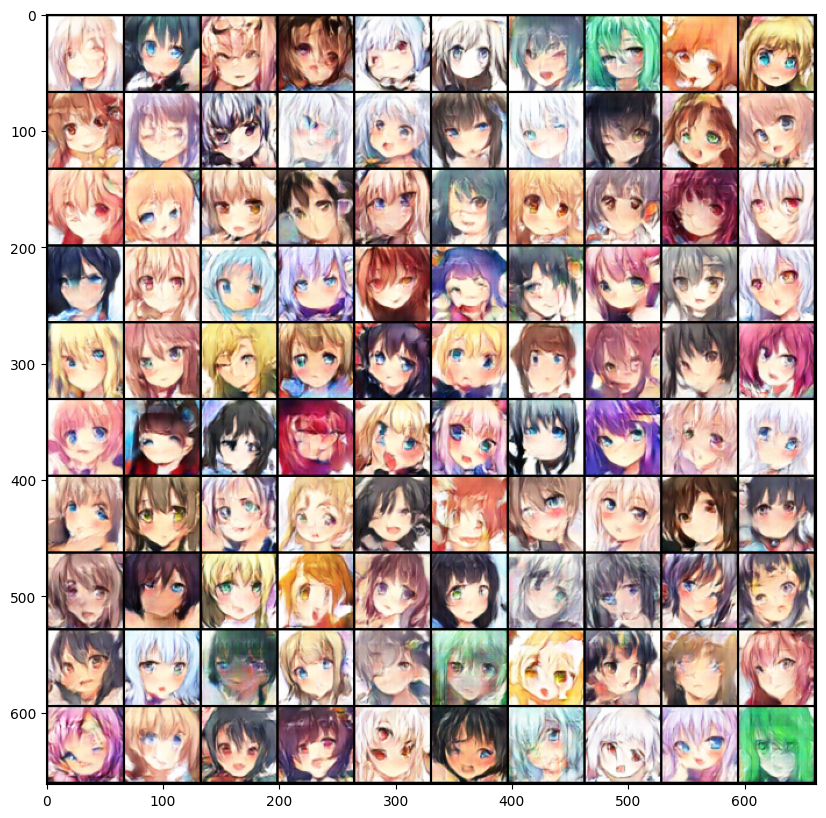

Epoch 46: 100%|██████████| 558/558 [00:41<00:00, 13.57it/s, loss_D=-29.1, loss_G=72.2] 
2024-02-26 23:07 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_046.jpg.
Epoch 47: 100%|██████████| 558/558 [00:41<00:00, 13.57it/s, loss_D=7.3, loss_G=40.9]    
2024-02-26 23:08 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_047.jpg.
Epoch 48: 100%|██████████| 558/558 [00:41<00:00, 13.55it/s, loss_D=-33.1, loss_G=30.1]  
2024-02-26 23:09 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_048.jpg.
Epoch 49: 100%|██████████| 558/558 [00:41<00:00, 13.45it/s, loss_D=-34.1, loss_G=58.9] 
2024-02-26 23:09 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_049.jpg.
Epoch 50: 100%|██████████| 558/558 [00:41<00:00, 13.34it/s, loss_D=-17.2, loss_G=13.4]  
2024-02-26 23:10 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_050.jpg.


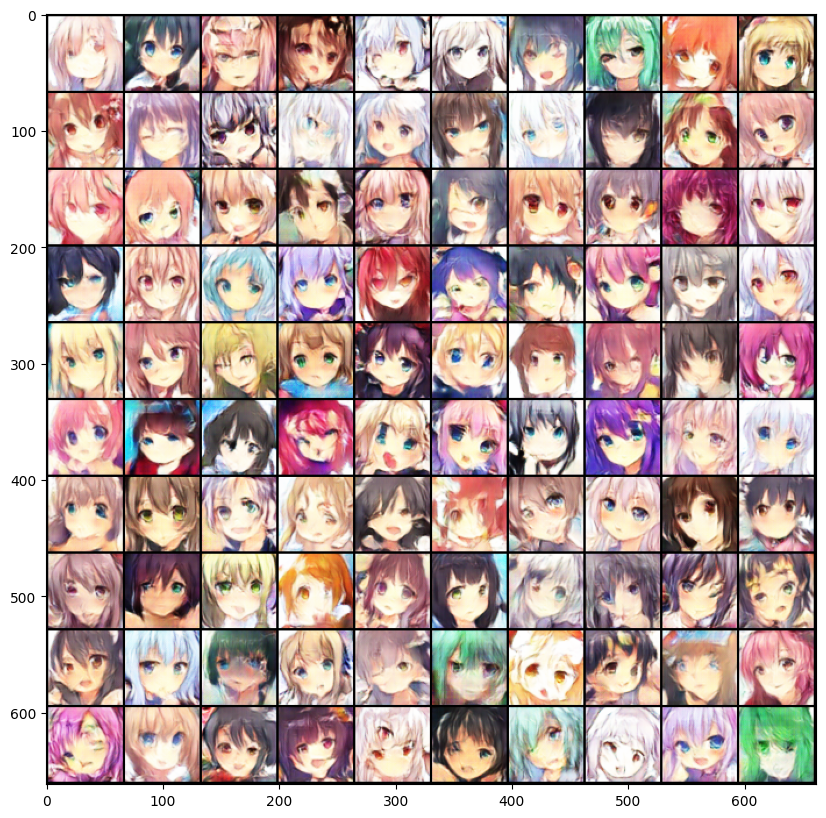

Epoch 51: 100%|██████████| 558/558 [00:41<00:00, 13.53it/s, loss_D=-35.1, loss_G=3.62]
2024-02-26 23:11 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_051.jpg.
Epoch 52: 100%|██████████| 558/558 [00:41<00:00, 13.42it/s, loss_D=-35.3, loss_G=62.3] 
2024-02-26 23:11 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_052.jpg.
Epoch 53: 100%|██████████| 558/558 [00:41<00:00, 13.37it/s, loss_D=-24.3, loss_G=32.1] 
2024-02-26 23:12 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_053.jpg.
Epoch 54: 100%|██████████| 558/558 [00:41<00:00, 13.49it/s, loss_D=-35.3, loss_G=99.7]
2024-02-26 23:13 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_054.jpg.
Epoch 55: 100%|██████████| 558/558 [00:41<00:00, 13.54it/s, loss_D=-23.5, loss_G=36.5]
2024-02-26 23:13 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_055.jpg.


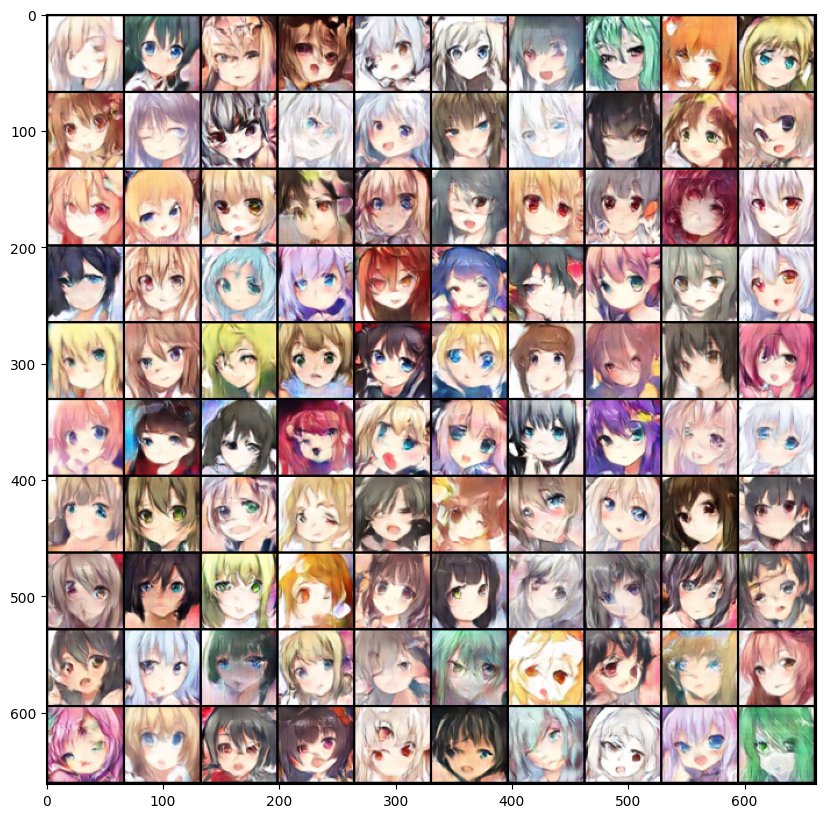

Epoch 56: 100%|██████████| 558/558 [00:41<00:00, 13.54it/s, loss_D=-34.3, loss_G=122]   
2024-02-26 23:14 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_056.jpg.
Epoch 57: 100%|██████████| 558/558 [00:41<00:00, 13.54it/s, loss_D=-38.5, loss_G=-9.09]
2024-02-26 23:15 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_057.jpg.
Epoch 58: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=-17.5, loss_G=48.3] 
2024-02-26 23:15 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_058.jpg.
Epoch 59: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=-27.2, loss_G=43.7]
2024-02-26 23:16 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_059.jpg.
Epoch 60: 100%|██████████| 558/558 [00:41<00:00, 13.55it/s, loss_D=-28.5, loss_G=-1.35]
2024-02-26 23:17 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_060.jpg.


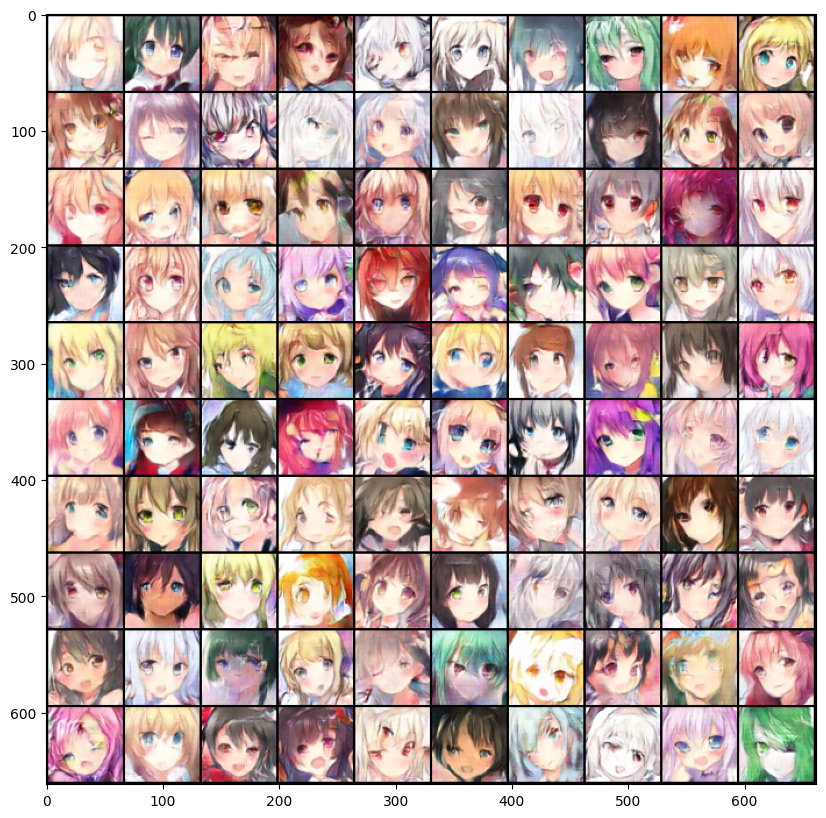

Epoch 61: 100%|██████████| 558/558 [00:41<00:00, 13.57it/s, loss_D=-23.4, loss_G=80.9] 
2024-02-26 23:18 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_061.jpg.
Epoch 62: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=-35.4, loss_G=80.5] 
2024-02-26 23:18 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_062.jpg.
Epoch 63: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=-26.9, loss_G=51.6] 
2024-02-26 23:19 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_063.jpg.
Epoch 64: 100%|██████████| 558/558 [00:41<00:00, 13.57it/s, loss_D=-35, loss_G=13.2]    
2024-02-26 23:20 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_064.jpg.
Epoch 65: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=-26.1, loss_G=55.3]
2024-02-26 23:20 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_065.jpg.


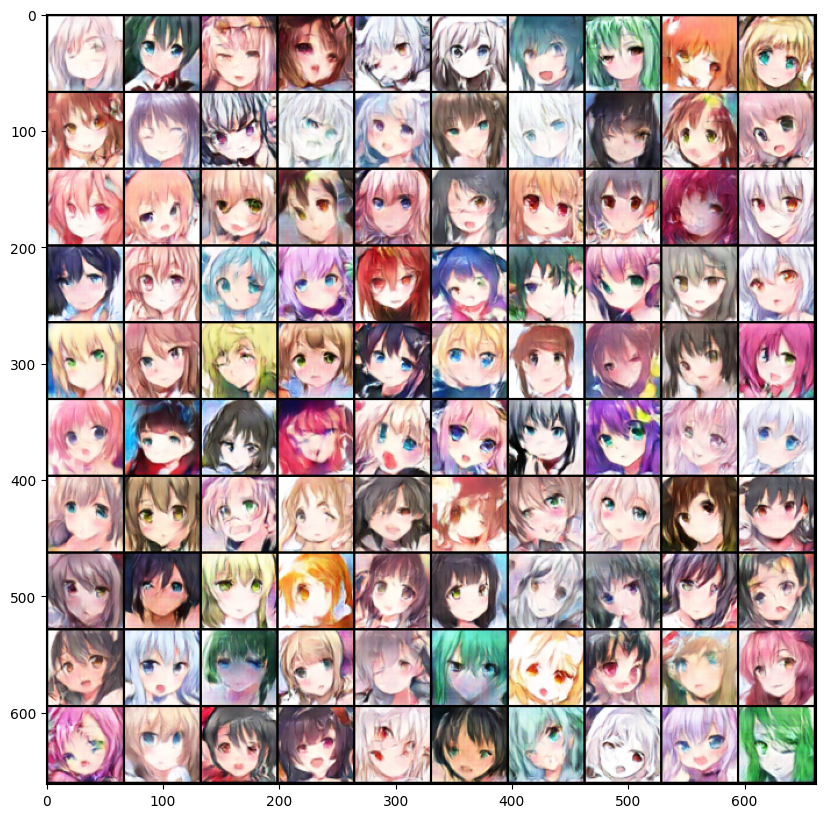

Epoch 66: 100%|██████████| 558/558 [00:41<00:00, 13.59it/s, loss_D=-17.5, loss_G=53.4]
2024-02-26 23:21 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_066.jpg.
Epoch 67: 100%|██████████| 558/558 [00:41<00:00, 13.59it/s, loss_D=-25.6, loss_G=25.5] 
2024-02-26 23:22 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_067.jpg.
Epoch 68: 100%|██████████| 558/558 [00:41<00:00, 13.53it/s, loss_D=-24, loss_G=46.1]   
2024-02-26 23:22 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_068.jpg.
Epoch 69: 100%|██████████| 558/558 [00:41<00:00, 13.51it/s, loss_D=-14.1, loss_G=95.4]  
2024-02-26 23:23 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_069.jpg.
Epoch 70: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=-15, loss_G=35.8]   
2024-02-26 23:24 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_070.jpg.


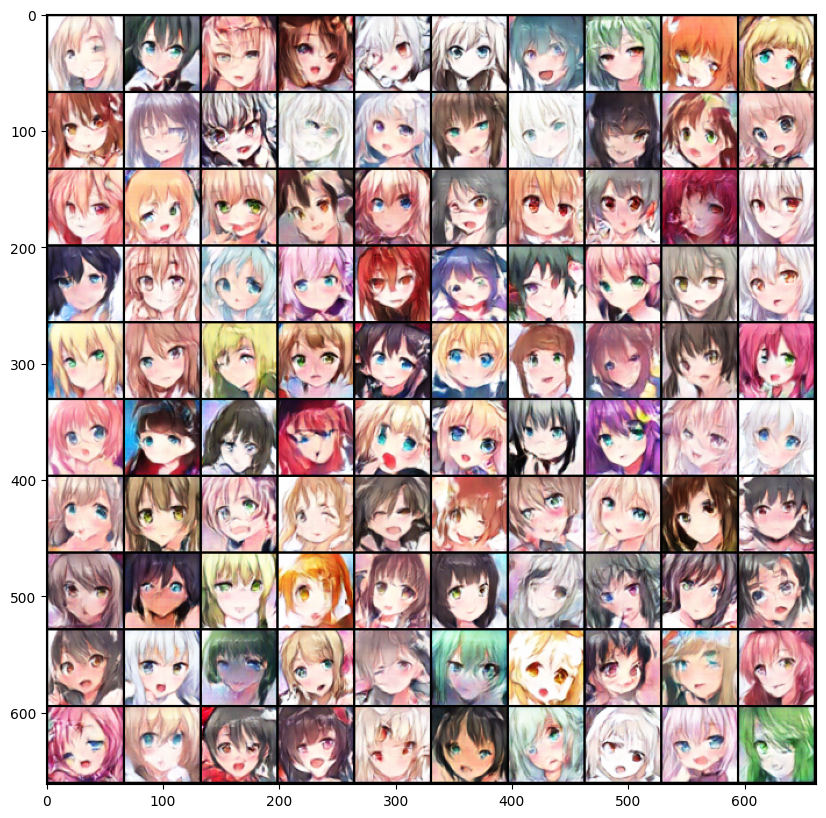

Epoch 71: 100%|██████████| 558/558 [00:41<00:00, 13.58it/s, loss_D=-17.4, loss_G=49]   
2024-02-26 23:24 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_071.jpg.
Epoch 72: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=-32.1, loss_G=94.7] 
2024-02-26 23:25 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_072.jpg.
Epoch 73: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=-24.1, loss_G=72.6] 
2024-02-26 23:26 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_073.jpg.
Epoch 74: 100%|██████████| 558/558 [00:41<00:00, 13.57it/s, loss_D=-35.3, loss_G=16.5] 
2024-02-26 23:27 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_074.jpg.
Epoch 75: 100%|██████████| 558/558 [00:41<00:00, 13.58it/s, loss_D=-32.4, loss_G=35.4]
2024-02-26 23:27 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_075.jpg.


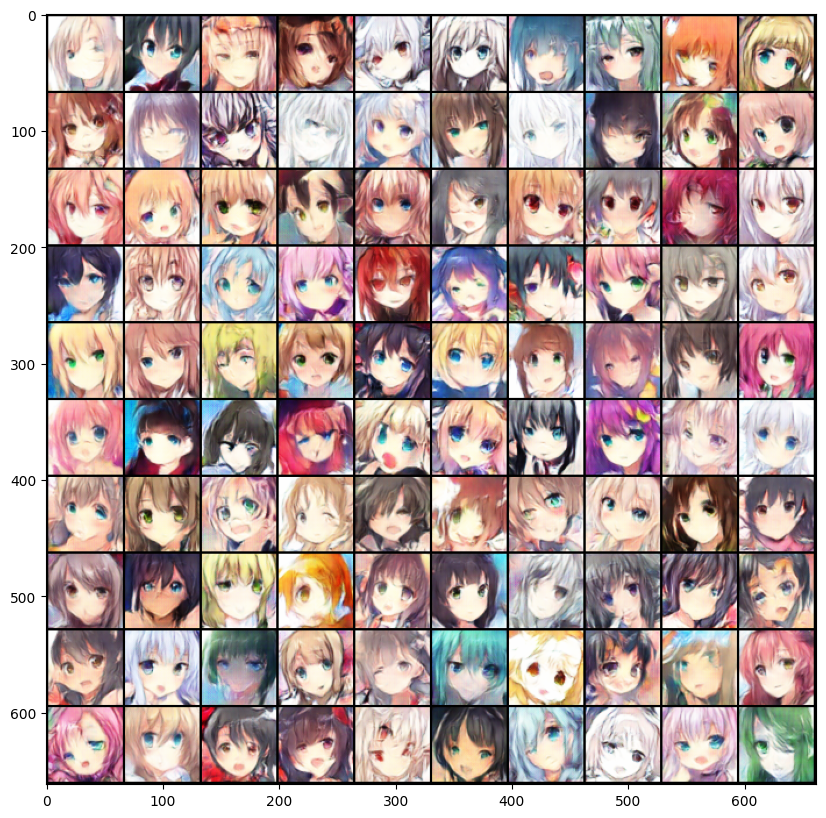

Epoch 76: 100%|██████████| 558/558 [00:41<00:00, 13.59it/s, loss_D=-29, loss_G=36.5]   
2024-02-26 23:28 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_076.jpg.
Epoch 77: 100%|██████████| 558/558 [00:41<00:00, 13.55it/s, loss_D=-32.3, loss_G=79.7]
2024-02-26 23:29 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_077.jpg.
Epoch 78: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=-27.6, loss_G=107]  
2024-02-26 23:29 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_078.jpg.
Epoch 79: 100%|██████████| 558/558 [00:41<00:00, 13.57it/s, loss_D=-33.5, loss_G=8.21] 
2024-02-26 23:30 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_079.jpg.
Epoch 80: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=-25.2, loss_G=54.8]
2024-02-26 23:31 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_080.jpg.


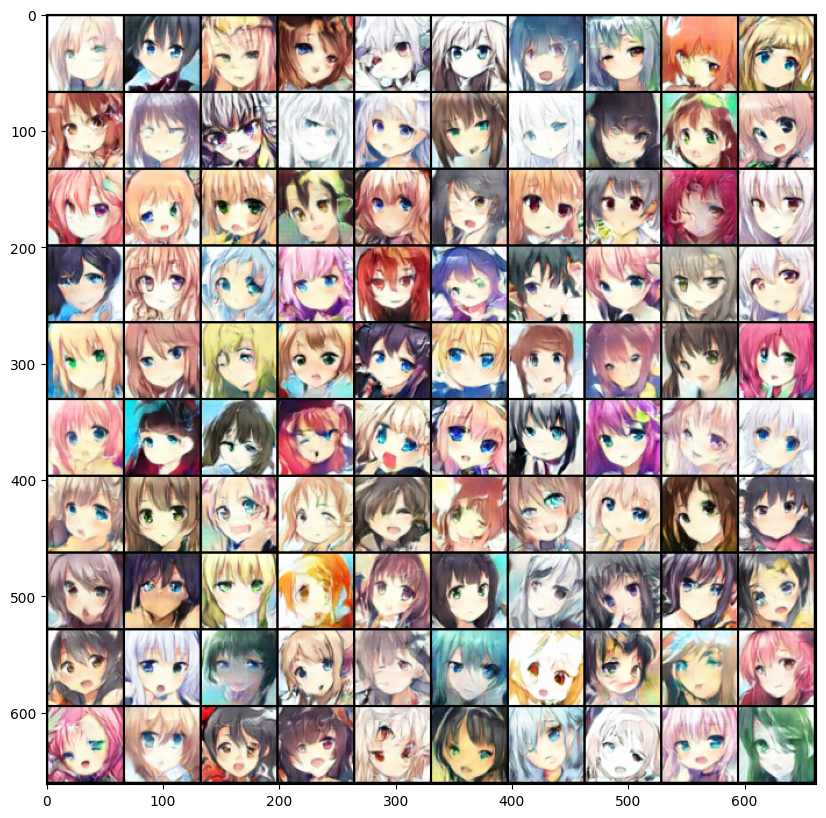

Epoch 81: 100%|██████████| 558/558 [00:41<00:00, 13.57it/s, loss_D=-41.3, loss_G=2.4]  
2024-02-26 23:31 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_081.jpg.
Epoch 82: 100%|██████████| 558/558 [00:41<00:00, 13.57it/s, loss_D=-23.5, loss_G=50.6] 
2024-02-26 23:32 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_082.jpg.
Epoch 83: 100%|██████████| 558/558 [00:41<00:00, 13.58it/s, loss_D=-37.4, loss_G=32.4] 
2024-02-26 23:33 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_083.jpg.
Epoch 84: 100%|██████████| 558/558 [00:41<00:00, 13.57it/s, loss_D=-28.3, loss_G=76.5] 
2024-02-26 23:33 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_084.jpg.
Epoch 85: 100%|██████████| 558/558 [00:41<00:00, 13.57it/s, loss_D=-28.3, loss_G=20.1] 
2024-02-26 23:34 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_085.jpg.


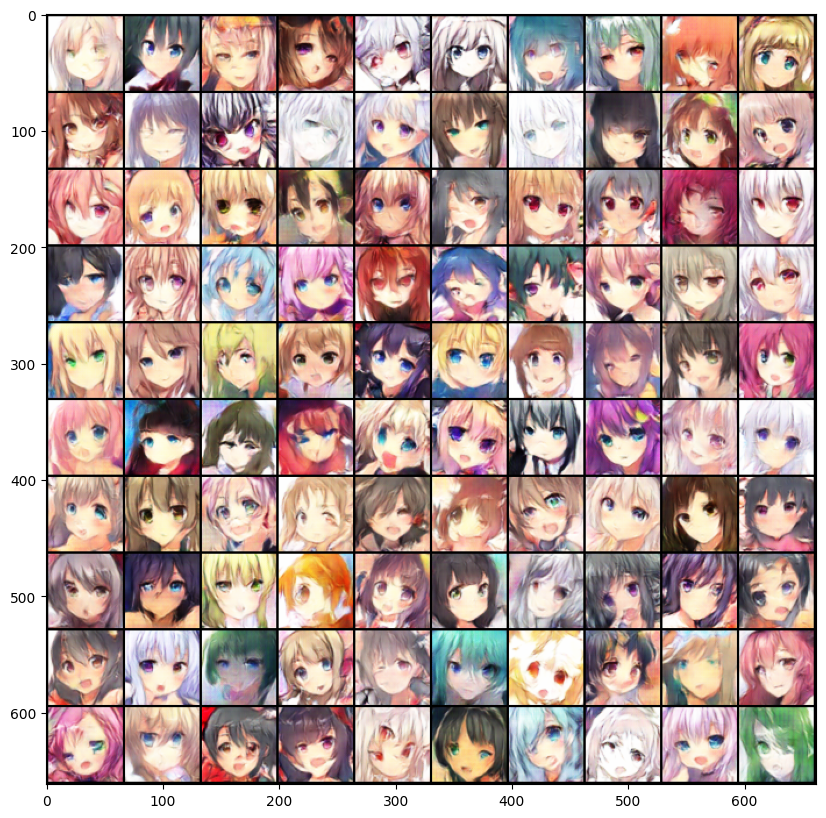

Epoch 86: 100%|██████████| 558/558 [00:41<00:00, 13.57it/s, loss_D=-24.3, loss_G=46.6] 
2024-02-26 23:35 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_086.jpg.
Epoch 87: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=-28.8, loss_G=67]  
2024-02-26 23:35 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_087.jpg.
Epoch 88: 100%|██████████| 558/558 [00:41<00:00, 13.57it/s, loss_D=-18.3, loss_G=44]   
2024-02-26 23:36 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_088.jpg.
Epoch 89: 100%|██████████| 558/558 [00:41<00:00, 13.59it/s, loss_D=8.12, loss_G=55.7]  
2024-02-26 23:37 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_089.jpg.
Epoch 90: 100%|██████████| 558/558 [00:41<00:00, 13.57it/s, loss_D=-28.8, loss_G=17.9] 
2024-02-26 23:38 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_090.jpg.


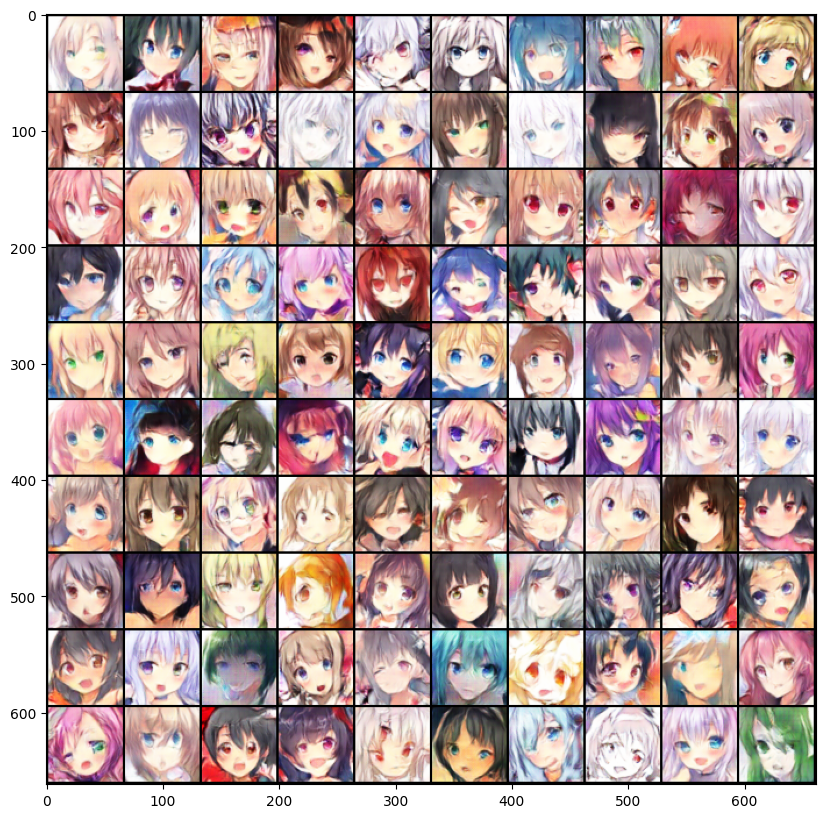

Epoch 91: 100%|██████████| 558/558 [00:41<00:00, 13.59it/s, loss_D=-18.5, loss_G=48.1]  
2024-02-26 23:38 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_091.jpg.
Epoch 92: 100%|██████████| 558/558 [00:41<00:00, 13.57it/s, loss_D=-24.7, loss_G=29]   
2024-02-26 23:39 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_092.jpg.
Epoch 93: 100%|██████████| 558/558 [00:41<00:00, 13.59it/s, loss_D=-33.6, loss_G=42.3] 
2024-02-26 23:40 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_093.jpg.
Epoch 94: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=-25.3, loss_G=49.6]
2024-02-26 23:40 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_094.jpg.
Epoch 95: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=-29.9, loss_G=82.1] 
2024-02-26 23:41 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_095.jpg.


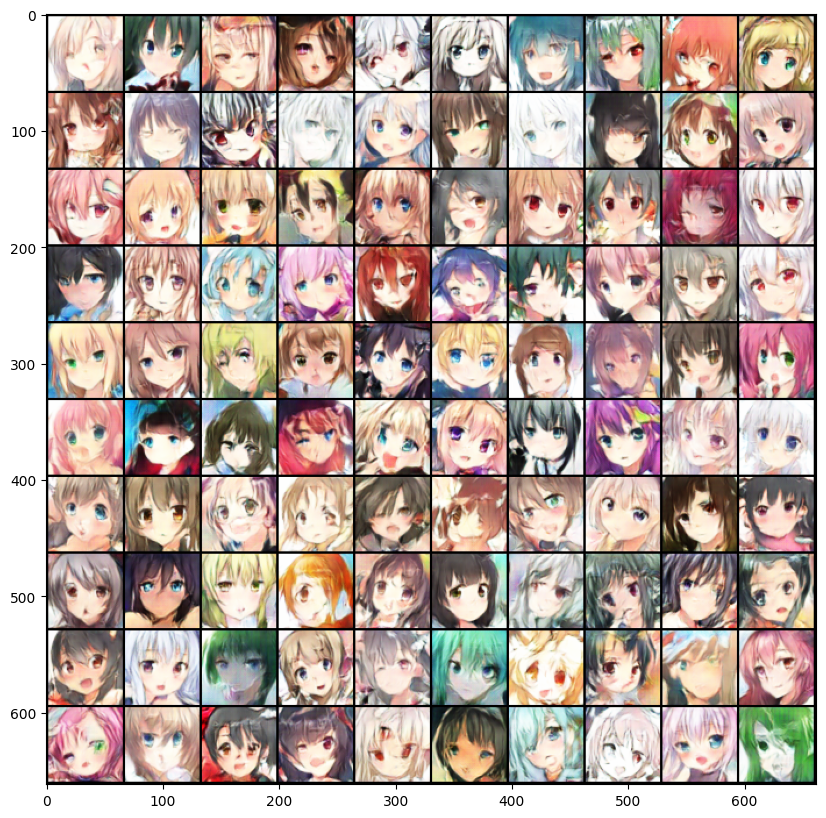

Epoch 96: 100%|██████████| 558/558 [00:41<00:00, 13.56it/s, loss_D=-31.3, loss_G=92.7] 
2024-02-26 23:42 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_096.jpg.
Epoch 97: 100%|██████████| 558/558 [00:41<00:00, 13.57it/s, loss_D=-21.5, loss_G=50.4] 
2024-02-26 23:42 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_097.jpg.
Epoch 98: 100%|██████████| 558/558 [00:41<00:00, 13.57it/s, loss_D=-22.4, loss_G=13.4] 
2024-02-26 23:43 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_098.jpg.
Epoch 99: 100%|██████████| 558/558 [00:41<00:00, 13.57it/s, loss_D=-33.7, loss_G=7.06]
2024-02-26 23:44 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_099.jpg.
Epoch 100: 100%|██████████| 558/558 [00:41<00:00, 13.57it/s, loss_D=-30.7, loss_G=0.83]
2024-02-26 23:44 - INFO: Save some samples to ./logs/2024-02-26_22-35-58_WGAN-GP/Epoch_100.jpg.


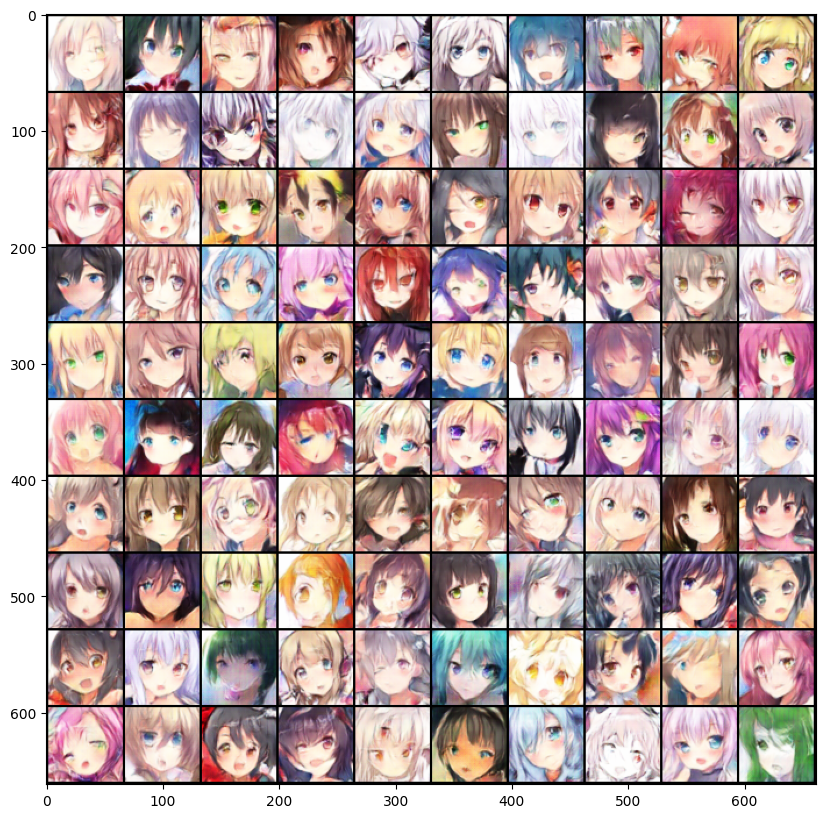

2024-02-26 23:44 - INFO: Finish training


In [10]:
trainer = TrainerGAN(config)
trainer.train()

# Inference
In this section, we will use trainer to train model

## Inference through trainer

In [16]:
# save the 1000 images into ./output folder
which_epoch = 99 # 哪个epoch?
trainer.inference(f'{workspace_dir}/checkpoints/{global_time}_{config["model_type"]}/G_{which_epoch}.pth') # you have to modify the path when running this line

## Prepare .tar file for submission

In [17]:
%cd output
!tar -zcf ../submission.tgz *.jpg
%cd ..

/media/ubuntu/D/GAN/MyStyleGAN/output


/usr/local/lib/python3.10/dist-packages/IPython/core/magics/osm.py:417: UserWarning: using dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


/media/ubuntu/D/GAN/MyStyleGAN
